In [1]:
import os
import sys
import re
import uuid
import random
import imageio
import json
import numpy as np
import torch
import torch_scatter

from scipy import misc
from PIL import Image
from tqdm import tqdm
from enum import Enum
from IPython import display

import matplotlib.pyplot as plt


/tmp/ipykernel_32546/2018461445.py:12: DeprecationWarning: scipy.misc is deprecated and will be removed in 2.0.0
  from scipy import misc


In [2]:
def get_cam_type(cam_type):
    
    CamType = Enum("CamType", ("CAM_B0", "CAM_F0", "CAM_L0", "CAM_L1", "CAM_L2", "CAM_R0", "CAM_R1", "CAM_R2"))

    assert cam_type in CamType.__members__, f"cam_type must be one of {CamType.__members__.keys()}"
    assert cam_type == CamType[cam_type].name
    cam_type = CamType[cam_type]

    return cam_type

def as_gif(images, path="temp.gif"):
  # Render the images as the gif (15Hz control frequency):
  images[0].save(path, save_all=True, append_images=images[1:], duration=int(1000/15), loop=0)
  gif_bytes = open(path,"rb").read()
  return gif_bytes

In [6]:
data_dir = "../data/navsim_org"
img_dir = "../data/navsim_cam/openscene_sensor_trainval_camera/openscene-v1.1/sensor_blobs/trainval"
available_scenes = []
for file in os.listdir(img_dir):
    if len(os.listdir(os.path.join(img_dir, file, "CAM_F0"))) >= 150:
        available_scenes.append(file)
        # print(file)
available_scenes = sorted(available_scenes)
print("Number of Available scenes: ", len(available_scenes))
for scene in available_scenes:
    print(f"{scene}: {len(os.listdir(os.path.join(img_dir, scene, 'CAM_F0')))}")

Number of Available scenes:  5
2021.06.08.17.36.50_veh-26_03873_04225: 700
2021.06.09.17.23.18_veh-38_00305_00597: 584
2021.06.23.17.31.36_veh-16_00634_01421: 1574
2021.07.16.00.51.05_veh-17_01352_01901: 1098
2021.10.05.07.38.12_veh-50_01085_01463: 756


In [10]:
cam_type = get_cam_type("CAM_F0")
scene = random.choice(available_scenes)
info = np.load(os.path.join(data_dir, "navsim_logs", "trainval", f"{scene}.pkl"), allow_pickle=True)
info_available = [info[i] for i in range(len(info)) if os.path.exists(os.path.join(img_dir, info[i]['cams'][cam_type.name]['data_path']))]
print("Scene: ", scene, "\nCamType: ", cam_type.name, "\nNumber of images: ", len(info_available))

Scene:  2021.06.09.17.23.18_veh-38_00305_00597 
CamType:  CAM_F0 
Number of images:  584


100%|██████████| 583/583 [00:16<00:00, 35.75it/s]


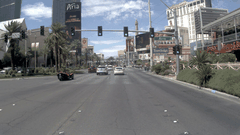

In [11]:
plt.style.use("seaborn-v0_8-whitegrid")

images = []
for i in tqdm(range(0, len(info_available) - 1)):
    img_path = os.path.join(img_dir, info_available[i]['cams'][cam_type.name]['data_path'])
    img = Image.open(img_path)
    # plt.imshow(img)
    # plt.axis('off')
    # break
    W, H = img.size
    img = img.resize((int(W / 8), int(H / 8)), Image.LANCZOS)
    images.append(img)

display.Image(as_gif(images))